# Ileum Lamina Propria Immunocyte Subtypes (Martin et al.)

Dataset download: [Immune Cell Atlas](https://singlecell.broadinstitute.org/single_cell/study/SCP359/ica-ileum-lamina-propria-immunocytes-sinai?scpbr=immune-cell-atlas)

Article: [Single-Cell Analysis of Crohn’s Disease Lesions Identifies a Pathogenic Cellular Module Associated with Resistance to Anti-TNF Therapy](https://doi.org/10.1016/j.cell.2019.08.008)

In [1]:
import scanpy as sc
import os
import pandas as pd
import numpy as np
import pickle as pkl
import matplotlib as mpl
import matplotlib.pyplot as plt
import scipy.stats

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.n_jobs = 6

## Load data

In [3]:
adata = sc.read_10x_mtx("../../Ileum/", cache=True)
adata

... reading from cache file cache\..-..-Ileum-matrix.h5ad


AnnData object with n_obs × n_vars = 39671 × 33660
    var: 'gene_ids'

In [4]:
obs = pd.read_table("../../Ileum/Effi_tsne_final.txt", header=[0, 1])
obs.columns = [i[0] for i in obs.columns]
obs.index = obs.NAME
adata = adata[obs.NAME, :]
adata.obs = obs
adata.obs

C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\anndata\_core\anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


,NAME,X,Y,Primary Lineages,kmeans
NAME,,,,,
122_AAACCTGGTTCCCGAG,122_AAACCTGGTTCCCGAG,-17.523981,25.760201,IgA plasma cells,5
122_AAAGATGTCAGCTCTC,122_AAAGATGTCAGCTCTC,-4.299636,-1.107461,Tregs,2
122_AAAGCAACAAGAAGAG,122_AAAGCAACAAGAAGAG,18.438143,-1.855235,Mast cells,17
122_AAATGCCTCACCCGAG,122_AAATGCCTCACCCGAG,8.266746,4.860057,TRM,3
122_AACCATGCATCACCCT,122_AACCATGCATCACCCT,1.359606,36.710104,IgA plasma cells,10
...,...,...,...,...,...
209_TTTGTCAGTCTCTTAT,209_TTTGTCAGTCTCTTAT,11.309222,21.416638,TRM,1
209_TTTGTCAGTGTGGTTT,209_TTTGTCAGTGTGGTTT,23.971407,1.429820,Group3 ILC,13
209_TTTGTCATCAGTTAGC,209_TTTGTCATCAGTTAGC,8.514284,0.595697,TRM,3


In [5]:
adata.obs['batch'] = adata.obs.NAME.str[0:3]
print(*adata.obs['batch'].unique())

122 128 138 158 181 187 190 193 196 209


## SCANPY Analysis 

The dataset is already filtered, so no need to do additional QC.
Nevertheless, we show the figures.

normalizing counts per cell
    finished (0:00:00)


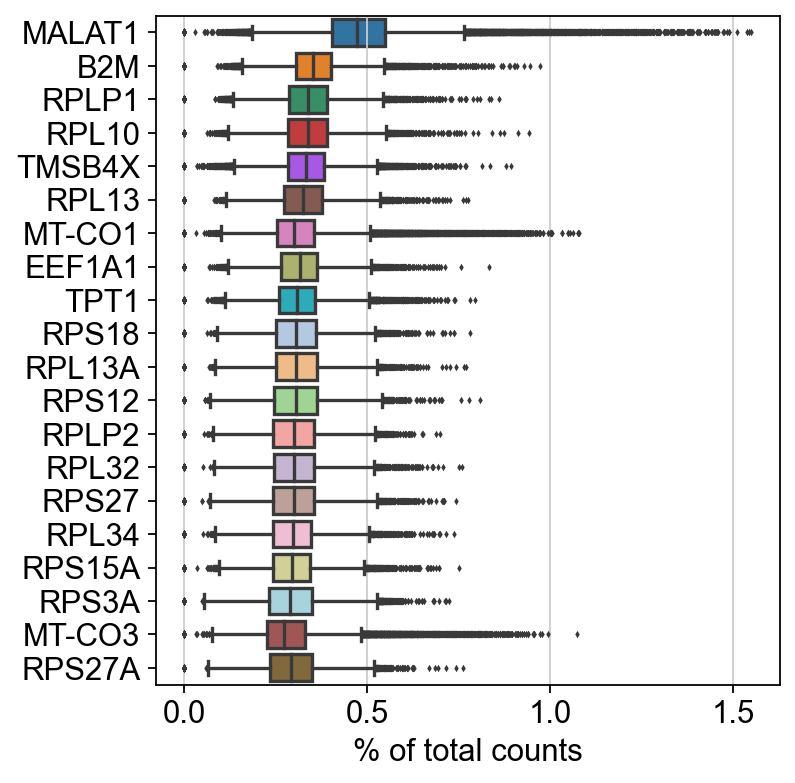

In [6]:
sc.settings.set_figure_params(dpi=80, facecolor='white')
sc.pl.highest_expr_genes(adata, n_top=20)

C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\anndata\_core\anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Primary Lineages' as categorical
... storing 'batch' as categorical
C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\seaborn\_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\seaborn\_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\seaborn\_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
C:\Users\SLiang3\

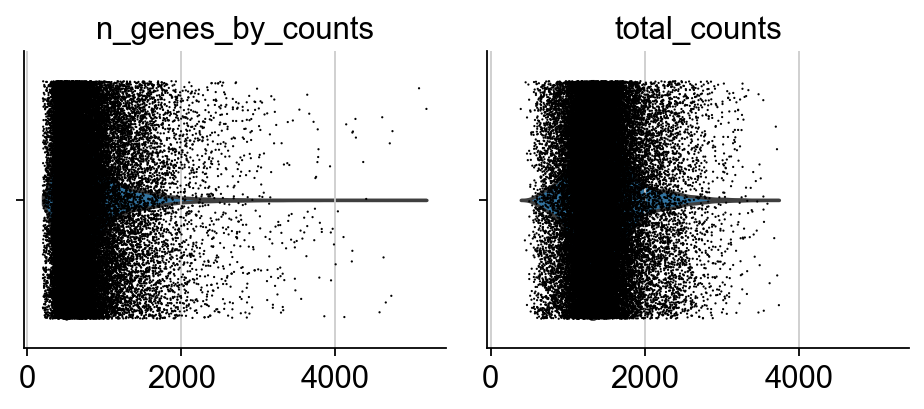

C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\anndata\_core\anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\seaborn\_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\seaborn\_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


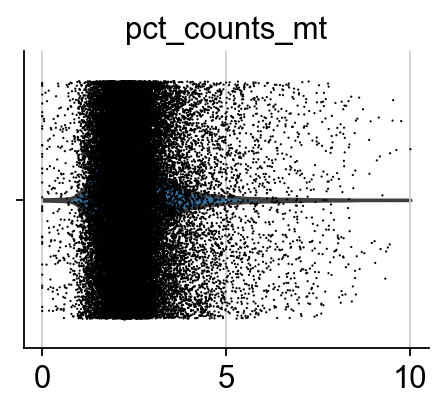

In [7]:
adata.var['mt'] = adata.var.index.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'], jitter=0.4, multi_panel=True)
sc.pl.violin(adata, ['pct_counts_mt'], jitter=0.4, multi_panel=True)

C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\anndata\_core\anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


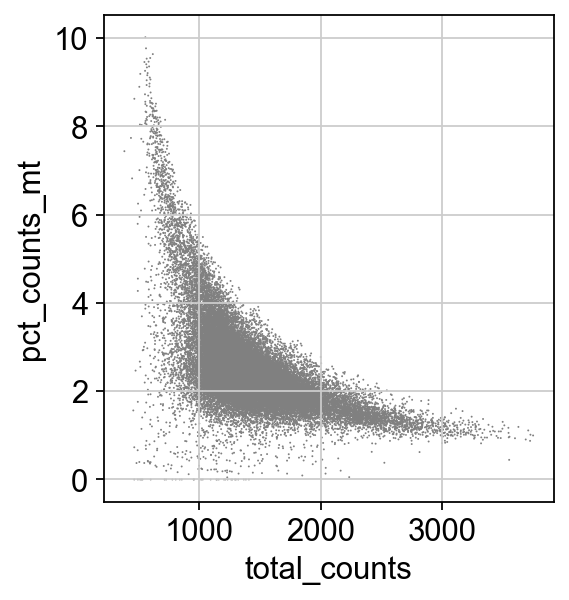

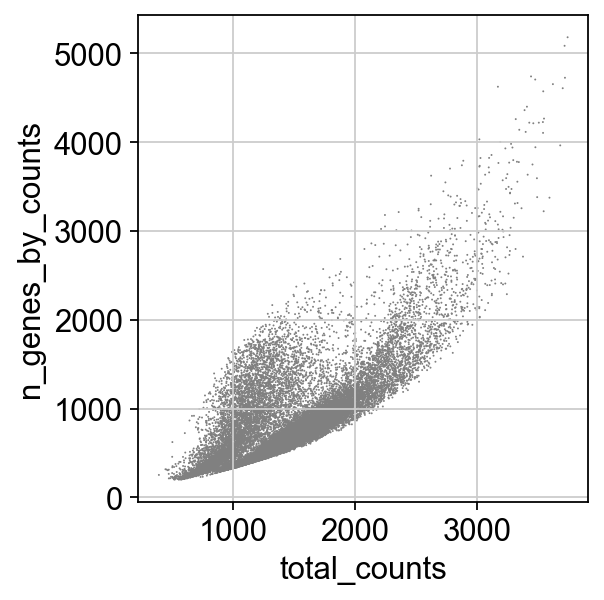

In [8]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [9]:
adata.raw = adata

In [10]:
sc.pp.filter_genes(adata, min_cells=3)

filtered out 11319 genes that are detected in less than 3 cells


C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\anndata\_core\anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [11]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

normalizing counts per cell
    finished (0:00:00)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


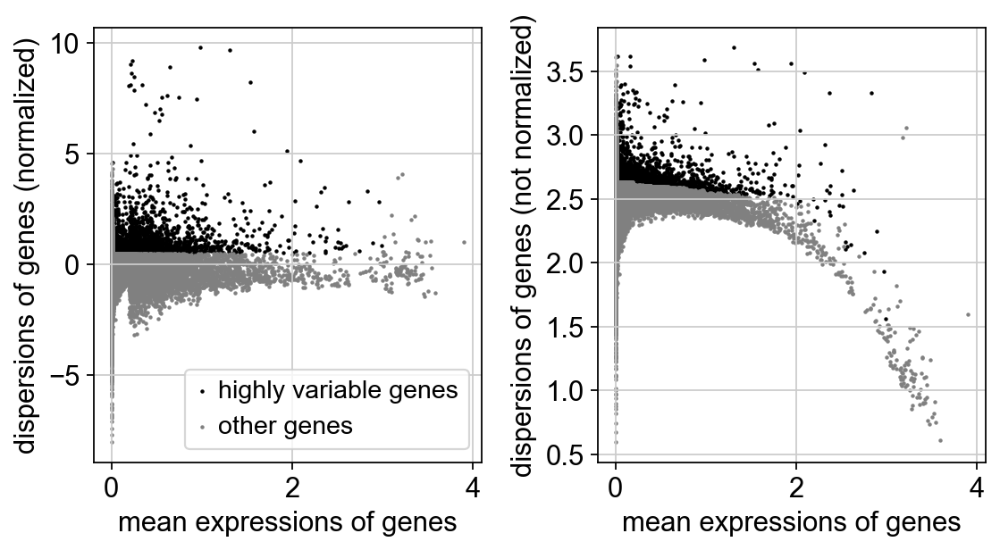

In [12]:
sc.pp.highly_variable_genes(adata)
sc.pl.highly_variable_genes(adata)

In [13]:
adata = adata[:, adata.var.highly_variable]
adata

View of AnnData object with n_obs × n_vars = 39563 × 3573
    obs: 'NAME', 'X', 'Y', 'Primary Lineages', 'kmeans', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [14]:
sc.pp.scale(adata, max_value=10)

C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\scanpy\preprocessing\_simple.py:806: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:11)


C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\anndata\_core\anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


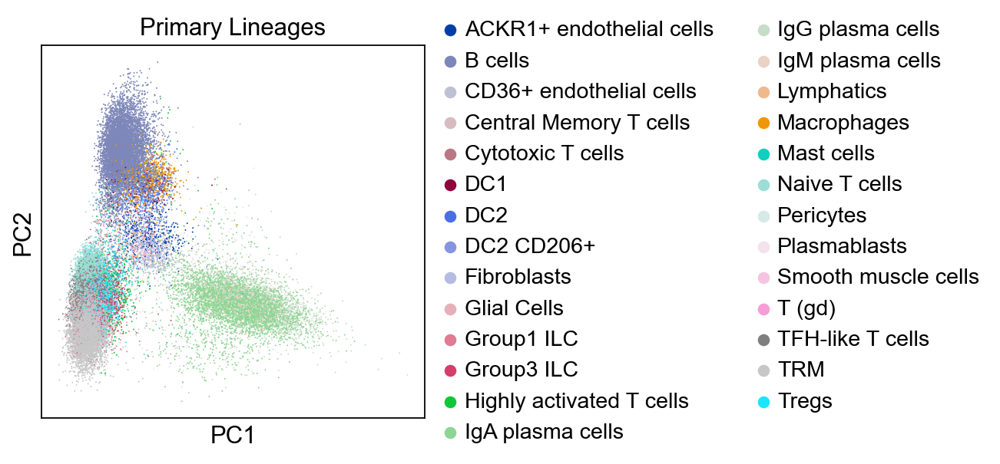

In [15]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca(adata, color="Primary Lineages")

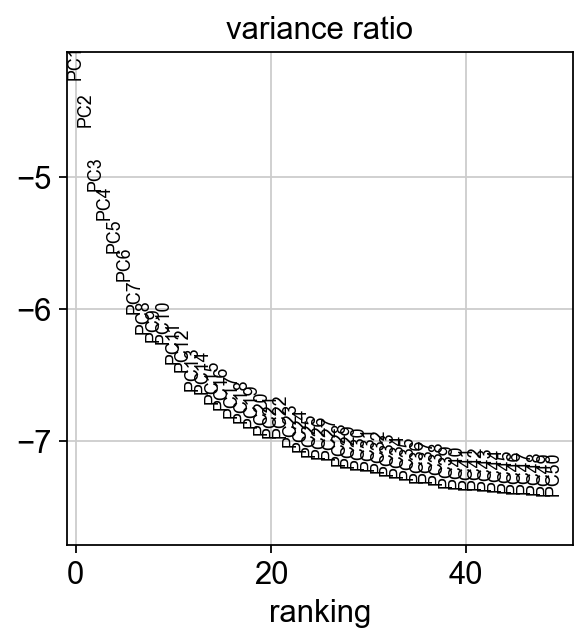

In [16]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=50)

In [17]:
# sc.tl.rank_genes_groups(adata, 'Primary Lineages', method='wilcoxon')
# sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, ncols=3)

In [18]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:17)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)


C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\anndata\_core\anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


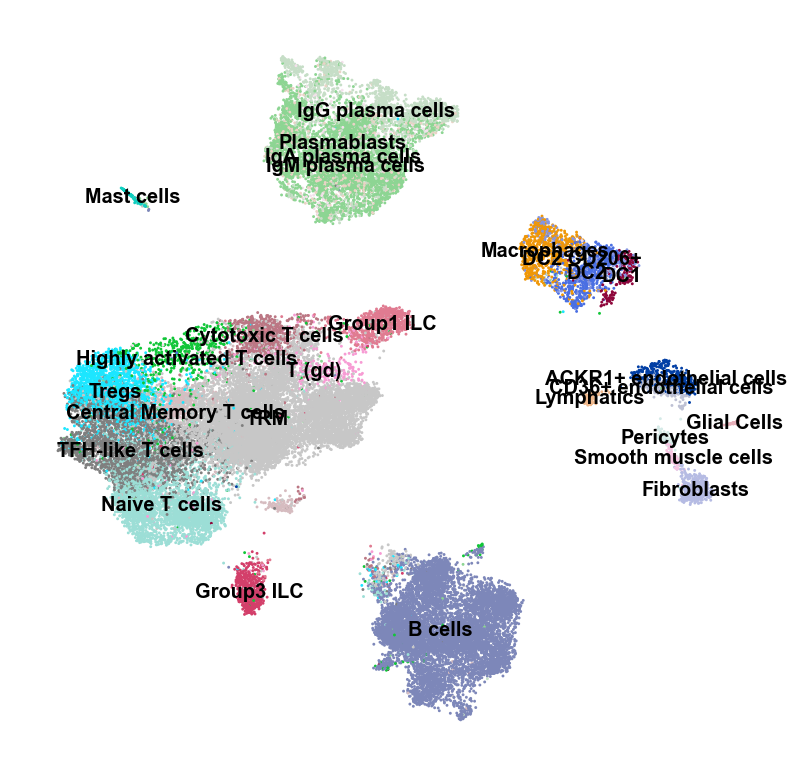

In [19]:
sc.settings.set_figure_params(dpi=120, facecolor='white')
sc.pl.umap(adata, color="Primary Lineages", legend_loc="on data", legend_fontsize=6, frameon=False, title="")

## SCMER Marker Selection

In [20]:
#%autoreload
import sys
sys.path.insert(0,'..')
import scmer
model = scmer.UmapL1(w=1., lasso=2.45e-4, ridge=2.45e-4, n_pcs=50, perplexity=100., use_beta_in_Q=True, n_threads=6, 
                            max_outer_iter=2)
model.fit(adata.X, batches=adata.obs['batch'].values)

Batch 122 with 437 instances.
Calculating distance matrix and scaling factors...
Computing pairwise distances...
Using 6 threads...
Mean value of sigma: 1.284627
Done. Elapsed time: 2.49 seconds. Total: 2.49 seconds.
Batch 128 with 2312 instances.
Calculating distance matrix and scaling factors...
Computing pairwise distances...
Using 6 threads...
Mean value of sigma: 1.006885
Done. Elapsed time: 6.60 seconds. Total: 9.09 seconds.
Batch 138 with 3830 instances.
Calculating distance matrix and scaling factors...
Computing pairwise distances...
Using 6 threads...
Mean value of sigma: 0.873896
Done. Elapsed time: 13.12 seconds. Total: 22.21 seconds.
Batch 158 with 3132 instances.
Calculating distance matrix and scaling factors...
Computing pairwise distances...
Using 6 threads...
Mean value of sigma: 0.890955
Done. Elapsed time: 9.92 seconds. Total: 32.13 seconds.
Batch 181 with 8782 instances.
Calculating distance matrix and scaling factors...
Computing pairwise distances...
Using 6 thre

In [21]:
selected_markers = adata.var_names[model.w > 0]
all_markers = adata.var_names

In [22]:
print(*selected_markers, sep=', ')

TNFRSF18, TNFRSF4, C1QA, C1QC, C1QB, ID3, LAPTM5, MARCKSL1, JUN, RP5-887A10.1, ODF2L, CHI3L2, SLC16A1-AS1, CD160, TXNIP, ACKR1, FCER1G, HSPA6, XCL2, XCL1, SELL, RGS1, ELF3, PIGR, SLC30A1, MTRNR2L11, AC092580.4, LINC00299, ID2, THADA, REG1B, REG1A, TRABD2A, GNLY, CD8A, CD8B, LINC00152, FABP1, IGKV1-12, IGKV3-15, DUSP2, MIR4435-2HG, IL1B, CXCR4, COL3A1, AC005540.3, STAT4, PGAP1, CD28, CTLA4, ICOS, CCL20, ITM2C, PASK, ANKRD28, CMC1, TRAT1, CD200, TIGIT, GPR171, RP11-3P17.5, KLHL6-AS1, CC2D2A, SMIM14, KIT, HOPX, IGFBP7, JCHAIN, AREG, CXCL13, PLAC8, SPARCL1, SPP1, BANK1, LEF1, FABP2, SPRY1, RP11-18H21.1, 1-Mar.1, IL7R, PTGER4, SEPP1, ITGA1, GZMK, GZMA, PDE4D, MZB1, CD74, FABP6, DUSP1, ADTRP, CD83, FAM65B, AIF1, HLA-DRA, HLA-DRB5, HLA-DRB1, HLA-DQA1, HLA-DQB1, HLA-DQB2, HLA-DMB, HLA-DMA, HLA-DPA1, HLA-DPB1, IL17A, AIM1, SESN1, FYN, TNFAIP3, CITED2, SYTL3, CCR6, ICA1, AGR2, IL6, CLDN4, COL1A2, RP11-138A9.1, CALD1, TRBC1, TRBC2, GIMAP7, PRDX4, SAT1, ZFX, SSR4, DEFA5, ADAMDEC1, DUSP4, RP11-51J9

## Validation

### PCA and UMAP

computing PCA
    on highly variable genes


C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\anndata\_core\anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    with n_comps=50
    finished (0:00:01)


C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\anndata\_core\anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


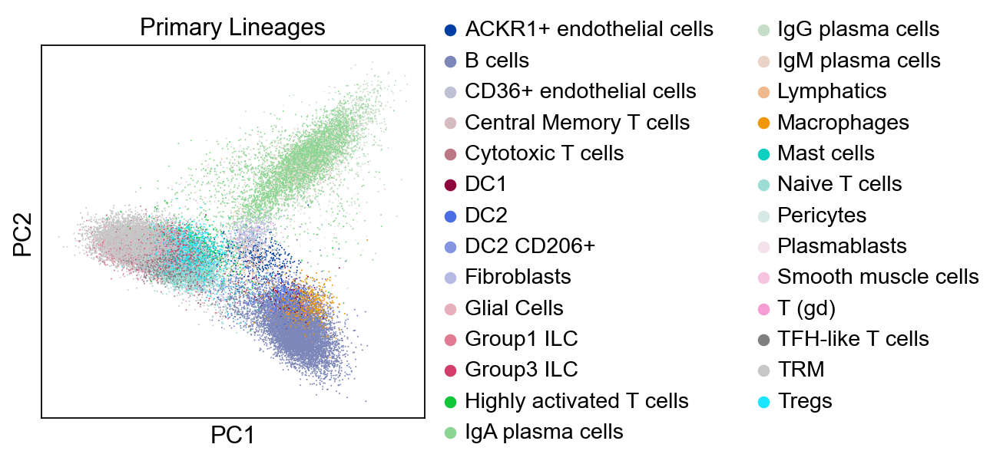

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:23)


C:\Users\SLiang3\Miniconda3\envs\scanpy37\lib\site-packages\anndata\_core\anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


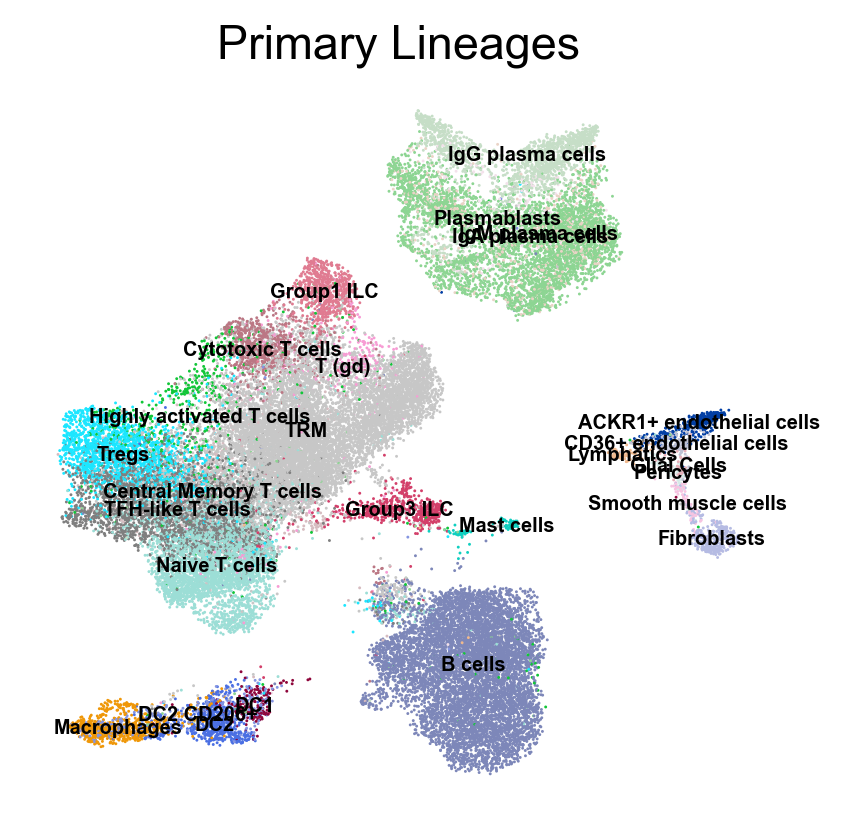

In [23]:
new_adata = model.transform(adata)
sc.tl.pca(new_adata, svd_solver='arpack')

sc.settings.set_figure_params(dpi=80, facecolor='white')
sc.pl.pca(new_adata, color="Primary Lineages")
sc.pp.neighbors(new_adata, n_pcs=20)
sc.tl.umap(new_adata)

sc.settings.set_figure_params(dpi=120, facecolor='white')
sc.pl.umap(new_adata, color="Primary Lineages", legend_loc="on data", legend_fontsize=6, frameon=False)

### Gene sets curated from the original publication

In [24]:
markers = {}
with open("../../Ileum/genes.txt", 'r') as file:
    for i in file.readlines():
        c, g = i.split(": ")
        markers[c] = g.strip().split(', ')

In [25]:
cnt = 0
recall_dict = []
for i in markers:
    temp = set(markers[i]).intersection(set(selected_markers))
    recall_dict.append([i, len(markers[i]), len(set(markers[i]).intersection(set(all_markers))), len(temp), ", ".join(temp)])

recall_dict = pd.DataFrame(recall_dict)
recall_dict.columns = ['Gene set', 'All', 'Highly variable', 'ManMark', 'Recalled Genes']
recall_dict.index = recall_dict['Gene set']
recall_dict.drop('Gene set', axis=1).style

,All,Highly variable,ManMark,Recalled Genes
Gene set,,,,
T cells,5,1,1,CD7
cell cycle,49,0,0,
immunoregulation,15,11,7,"TIGIT, IL2RA, ICA1, TBC1D4, TNFRSF4, CTLA4, BATF"
naive/central memory,7,6,3,"SELL, LEF1, CCR7"
CD8/cytotoxic,35,27,18,"CD8A, XCL1, CD160, FCER1G, KLRD1, CCL5, CMC1, NKG7, XCL2, KLRC1, GNLY, GZMA, KLRF1, CD8B, CCL4, CTSW, GZMB, CCL4L2"
resident memory,31,21,17,"TNFAIP3, CD69, PDE4D, SPRY1, AC092580.4, ANXA1, KLRB1, ANKRD28, IL7R, SYTL3, ID2, STAT4, RORA, JUN, FOS, GPR171, PTGER4"
T vs ILC,11,5,4,"TPSAB1, LYZ, TNFRSF17, MS4A1"
ILC,10,7,4,"FCER1G, TYROBP, CD7, KLRB1"
ILC1 including NK,4,2,1,IL7R


In [26]:
cnt = 0
for i in markers:
    temp = set(markers[i]).intersection(set(selected_markers))
    print(i, len(temp), '/', len(set(markers[i]).intersection(set(all_markers))), "(", len(markers[i]), "):", end="")
    print(*temp)
    
    if len(temp) > 0:
        cnt += 1
        
print()
print('Recalled', cnt, 'in', len(markers), 'gene sets.')

T cells 1 / 1 ( 5 ):CD7
cell cycle 0 / 0 ( 49 ):
immunoregulation 7 / 11 ( 15 ):TIGIT IL2RA ICA1 TBC1D4 TNFRSF4 CTLA4 BATF
naive/central memory 3 / 6 ( 7 ):SELL LEF1 CCR7
CD8/cytotoxic 18 / 27 ( 35 ):CD8A XCL1 CD160 FCER1G KLRD1 CCL5 CMC1 NKG7 XCL2 KLRC1 GNLY GZMA KLRF1 CD8B CCL4 CTSW GZMB CCL4L2
resident memory 17 / 21 ( 31 ):TNFAIP3 CD69 PDE4D SPRY1 AC092580.4 ANXA1 KLRB1 ANKRD28 IL7R SYTL3 ID2 STAT4 RORA JUN FOS GPR171 PTGER4
T vs ILC 4 / 5 ( 11 ):TPSAB1 LYZ TNFRSF17 MS4A1
ILC 4 / 7 ( 10 ):FCER1G TYROBP CD7 KLRB1
ILC1 including NK 1 / 2 ( 4 ):IL7R
ILC3 2 / 3 ( 9 ):IL22 RORA
PC 8 / 8 ( 12 ):LGALS1 FKBP2 DERL3 SEC11C SSR4 FKBP11 HSP90B1 XBP1
IgG 1 / 1 ( 1 ):CXCR4
IgM and IgA 1 / 1 ( 1 ):TNFRSF17
B 15 / 19 ( 21 ):CD79A HLA-DPB1 HLA-DQB1 BANK1 HLA-DRB5 HLA-DPA1 CD74 HLA-DMB HLA-DRB1 MS4A1 HLA-DQA1 HLA-DMA HLA-DRA CD79B HLA-DQB2
B naive 2 / 3 ( 3 ):FCER2 IGHD
B switched memory 1 / 1 ( 2 ):IGHG1
Mast 2 / 3 ( 3 ):KIT TPSAB1
Epithelial 15 / 20 ( 42 ):FABP1 IFI27 REG1A TFF3 PIGR REG1B DEFA5 

Genes not in any of these gene sets:

In [27]:
temp = set(selected_markers.copy())
for i in markers:
    temp -= set(markers[i])
    
print(*temp, sep=', ')

ITGA1, IGLV2-23, CD200, ZFP36, IRF8, SLC30A1, CHI3L2, AREG, ADTRP, SESN1, SPP1, CXCL13, IGHV3-74, MAF, CD83, RP11-51J9.5, IGLV3-19, IGLC7, COL3A1, LINC00299, LINC00152, RP11-138A9.1, SAT1, RP11-298J20.3, QSOX2, IGKV1-12, SMIM14, RTKN2, MT2A, PASK, IGLL1, CYB561A3, WT1-AS, KIAA0226L, CITED2, CCR6, IGHG2, RP11-291B21.2, TC2N, PRDX4, BCO2, HSPA6, TPSB2, CD28, ZFY, AIM1, TCL1A, IGHV1-2, TRABD2A, DMBT1, IGLV1-51, RP5-1028K7.2, IGLV2-11, TSHZ2, IGHG4, UTY, POU2AF1, CST7, ZNF10, AC005480.1, RNF19A, CCL20, CCL11, RNASE6, ZNF90, RP5-887A10.1, SLC16A1-AS1, DCN, ZSWIM4, KLHL6-AS1, ITM2C, USP9Y, LINC00402, GIMAP7, NTS, CREM, MIR4435-2HG, UBC, IGHG3, SEPP1, RGS1, VPREB3, ICOS, FAM65B, 1-Mar.1, TTTY15, JCHAIN, MT1E, AC008079.10, DNAJB1, RGCC, TRBC2, IGFBP7, TRBC1, HOPX, DUSP2, COL1A2, TRDC, PLAC8, CC2D2A, RP11-18H21.1, CST3, SNHG25, IGLC6, ODF2L, PGAP1, PHLDA1, ADAMDEC1, DUSP4, CH507-42P11.8, IGHGP, IGLC2, AC129778.2, ID3, IGLC5, IL17A, CALD1, IGKV3-15, GZMK, IGHA2, FAM118A, MARCKSL1, THADA, PRAP1, 

### Scatter plot of selected markers

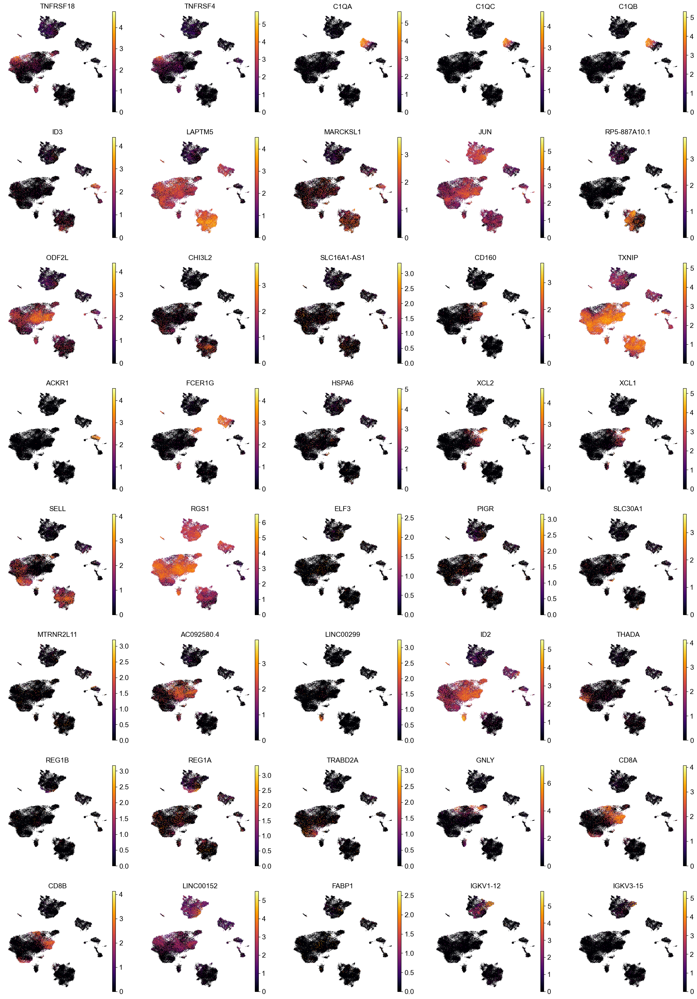

In [28]:
sc.settings.set_figure_params(dpi=50, facecolor='white')
sc.pl.umap(adata, color=selected_markers[0:40], frameon=False, ncols=5, color_map="inferno")

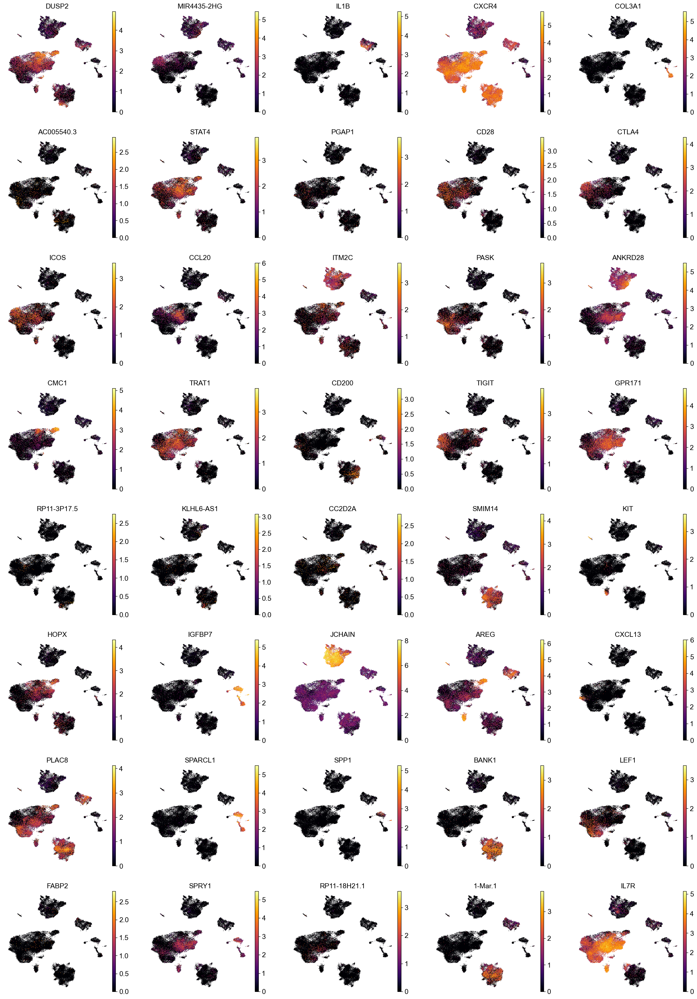

In [29]:
sc.pl.umap(adata, color=selected_markers[40:80], frameon=False, ncols=5, color_map="inferno")

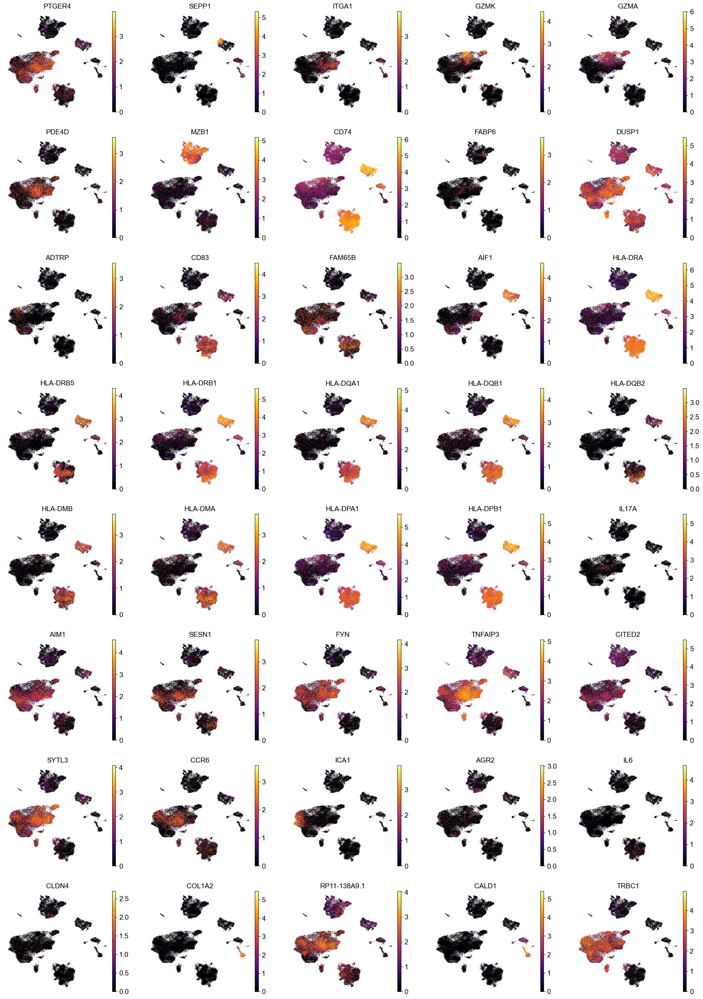

In [30]:
sc.pl.umap(adata, color=selected_markers[80:120], frameon=False, ncols=5, color_map="inferno")

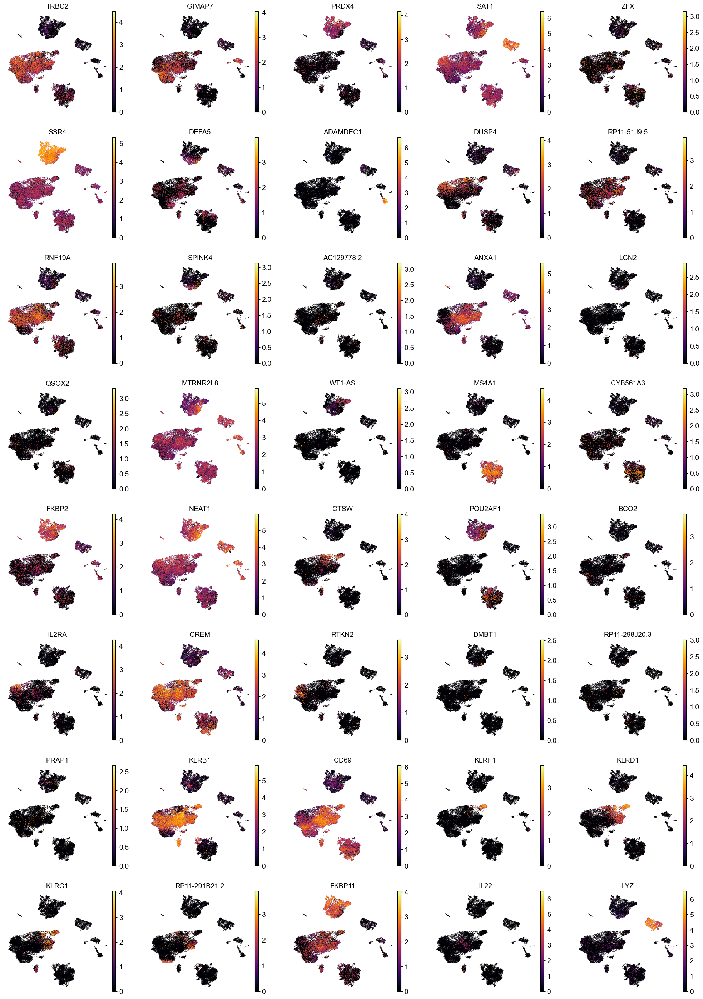

In [31]:
sc.pl.umap(adata, color=selected_markers[120:160], frameon=False, ncols=5, color_map="inferno")

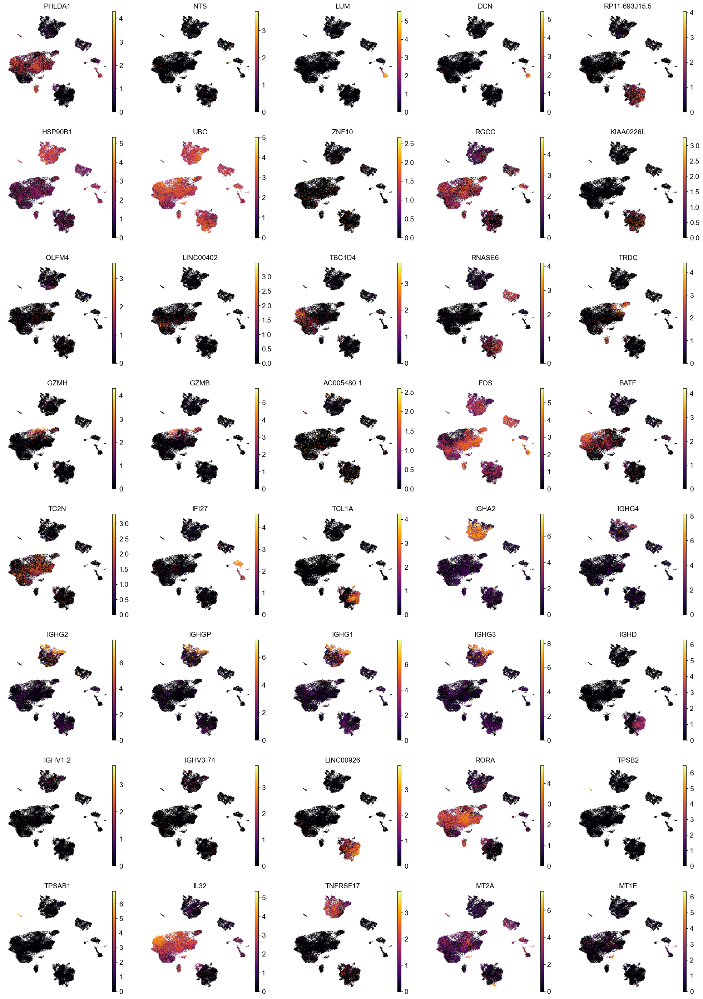

In [32]:
sc.pl.umap(adata, color=selected_markers[160:200], frameon=False, ncols=5, color_map="inferno")

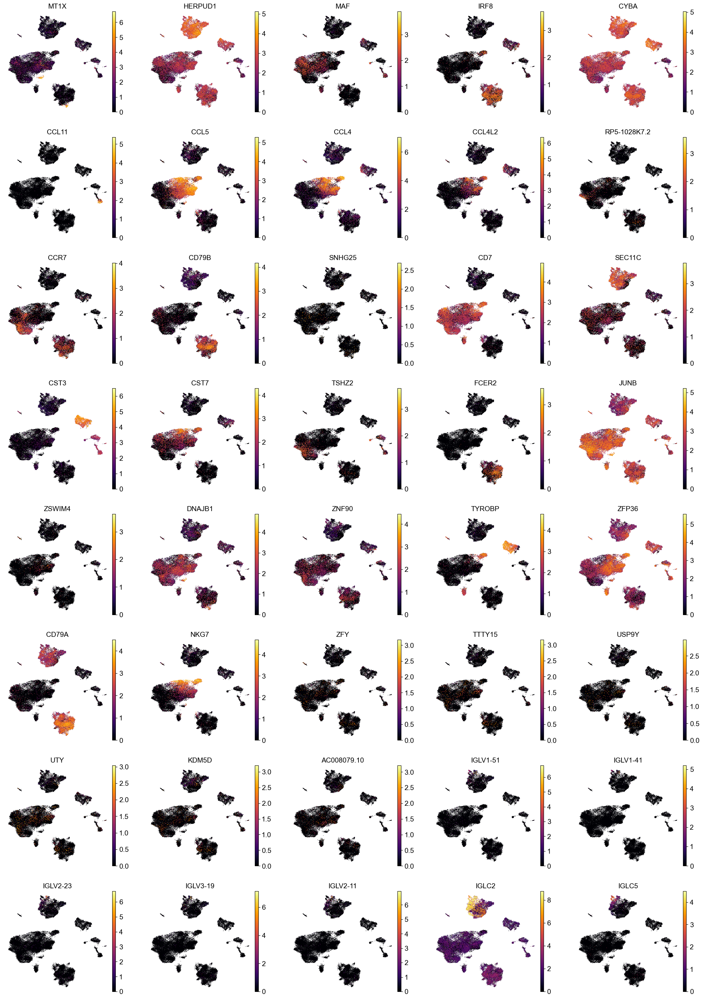

In [33]:
sc.pl.umap(adata, color=selected_markers[200:240], frameon=False, ncols=5, color_map="inferno")

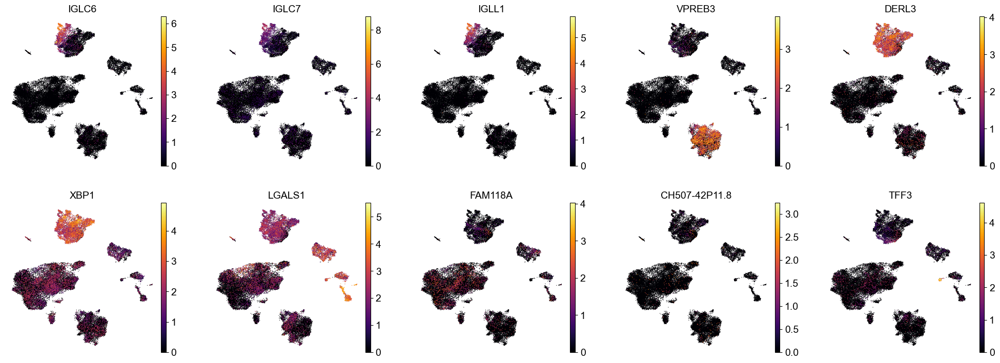

In [34]:
sc.pl.umap(adata, color=selected_markers[240:250], frameon=False, ncols=5, color_map="inferno")

### Violin plot of some markers

In [35]:
major_cell_type_dict = {
'IgA plasma cells': 'Plasma',
'Tregs': "T",
'Mast cells': "Mast",
'TRM': "T",
'Group3 ILC': 'ILC3',
'B cells': "B",
'DC2': 'Phagocytes',
'T (gd)': "T",
'IgM plasma cells': 'Plasma',
'TFH-like T cells': "T",
'Group1 ILC': 'ILC1',
'Fibroblasts': "Stromal",
'Macrophages': 'Phagocytes',
'IgG plasma cells': 'Plasma',
'DC2 CD206+': 'Phagocytes',
'DC1': 'Phagocytes',
'ACKR1+ endothelial cells': "Stromal",
'Central Memory T cells': "T",
'Naive T cells': "T",
'Cytotoxic T cells': "T",
'Highly activated T cells': "T",
'Pericytes': "Stromal",
'Plasmablasts': 'Plasma',
'CD36+ endothelial cells': "Stromal",
'Lymphatics': "Stromal",
'Smooth muscle cells': "Stromal",
'Glial Cells': "Stromal"
}

In [36]:
adata.obs['major cell types'] = adata.obs['Primary Lineages'].apply(major_cell_type_dict.__getitem__)

... storing 'major cell types' as categorical


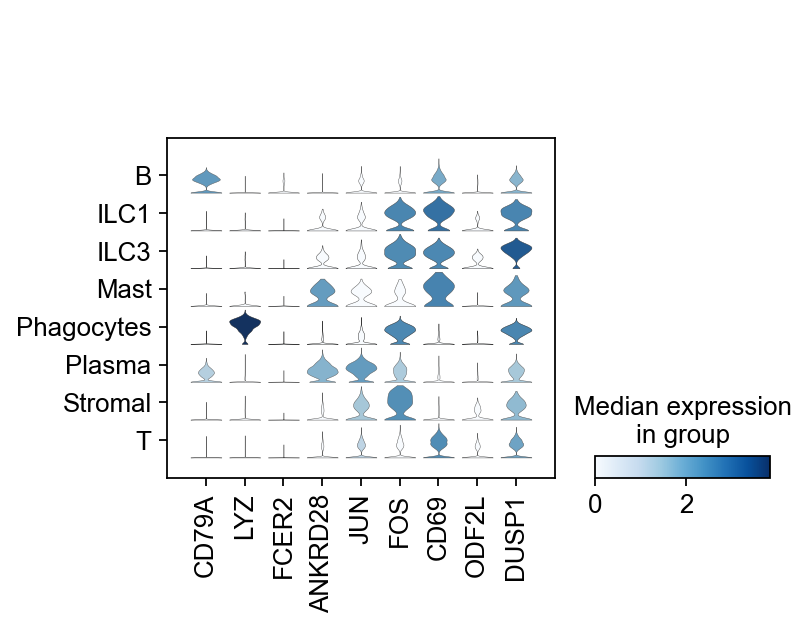

In [37]:
sc.settings.set_figure_params(dpi=80, facecolor='white')
sc.pl.stacked_violin(adata, ['CD79A', 'LYZ', 'FCER2', 'ANKRD28', 'JUN', 'FOS', 'CD69', 'ODF2L', 'DUSP1'], groupby="major cell types")

In [38]:
sc.logging.print_versions()

-----
anndata     0.7.4
scanpy      1.6.0
sinfo       0.3.1
-----
PIL                 7.2.0
anndata             0.7.4
backcall            0.2.0
cairo               1.19.1
cffi                1.14.2
colorama            0.4.3
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.1
decorator           4.4.2
get_version         2.1
h5py                2.10.0
igraph              0.8.2
importlib_metadata  1.7.0
ipykernel           5.3.4
ipython_genutils    0.2.0
ipywidgets          7.5.1
jedi                0.17.2
jinja2              2.11.2
joblib              0.16.0
kiwisolver          1.2.0
legacy_api_wrap     1.2
leidenalg           0.8.1
llvmlite            0.33.0+1.g022ab0f
markupsafe          1.1.1
matplotlib          3.3.1
mkl                 2.3.0
mpl_toolkits        NA
natsort             7.0.1
nt                  NA
ntsecuritycon       NA
numba               0.50.1
numexpr             2.7.1
numpy               1.19.1
packaging           20.4
pandas              